<a href="https://colab.research.google.com/github/JayRolla/market-sales-/blob/main/Big%20market%20sales%20prediction%20project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><b><h1>Big Market Sales Prediction</h1></b></center>


This project revolves around forecasting future sales for various types of supermarkets, each differing in size and location. Our primary objective is to glean valuable insights into the factors influencing sales performance, including product attributes and store characteristics. By leveraging advanced predictive analytics techniques, we aim to develop a robust Streamlit app capable of predicting sales based on these multifaceted factors. Through this initiative, we strive to empower stakeholders with actionable intelligence, revolutionizing decision-making processes in the retail landscape.

In [1]:
!pip install matplotlib

In [2]:
pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.9/357.9 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.4 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=99c5741fdfb61737e912725144016f2df2fa4ddd11517d109fcf686878dc708b
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.13.1
    Uninstalling seaborn-0.13.1:
      Successfully uninstalled seaborn-0.13.1


In [3]:
pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 29.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.6 MB/s eta 0:00:00


In [4]:
import pandas as pd
import numpy as np
#import pandas profiling for quick summary of data
from ydata_profiling import ProfileReport
#libraries for visualizing the data
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
# Preprocessing
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.preprocessing import StandardScaler
# Model selection and evaluation
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
#Statistical analysis
from scipy.stats import ttest_ind
from scipy.stats import f_oneway
from scipy.stats import chi2_contingency

# Machine learning models
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
# Utility
import joblib
from joblib import dump, load
import pickle
import streamlit as st

# Set up visualization settings for Jupyter Notebook (if using)
%matplotlib inline
sns.set_style("whitegrid")

In [5]:
train = pd.read_csv('https://raw.githubusercontent.com/JayRolla/market-sales-/main/train_market.csv')
test   = pd.read_csv('https://raw.githubusercontent.com/JayRolla/market-sales-/main/test_market.csv')

In this section I used pandas profiling to get an overview of the dataset, Pandas Profiling is a Python library that automatically generates detailed exploratory data analysis reports from a pandas DataFrame. It quickly provides insights through descriptive statistics, correlations, missing values analysis, and data type detection. This tool simplifies initial data assessments, helping to identify data quality issues and insights efficiently, making it ideal for both rapid assessments and in-depth exploratory analysis in data science projects.


In [6]:
profile = ProfileReport(train, title='Pandas Profiling Report on training data', explorative=True)
profile.to_widgets()

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:524: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
profile = ProfileReport(test, title='Pandas Profiling Report on test data', explorative=True)
profile.to_widgets()

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:524: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Item weight in both datasets contains missing values and there are a couple of NaN values in the outlet size


I proceed to make a copy of each dataset for versioning, data transformation and error recovery

In [8]:
df1 = train.copy()
df2 = test.copy()

The next step is to impute any missing values and NaNs in the identified columns

In [9]:
def impute_item_weight(df):
    """Impute missing Item_Weight based on the mean weight of the corresponding Item_Type."""
    return df.groupby('Item_Type')['Item_Weight'].transform(lambda x: x.fillna(x.mean()))

def impute_outlet_size(df):
    """Impute missing Outlet_Size based on the mode size of the corresponding Outlet_Type."""
    return df.groupby('Outlet_Type')['Outlet_Size'].transform(lambda x: x.fillna(x.mode()[0] if not x.mode().empty else np.nan))

'''
Now, i apply these functions to THE training and test datasets (df1 and df2),
Since I AM applying the same transformations to both datasets,
this approach ensures consistency in how missing values are handled across your datasets. '''


df1['Item_Weight'] = impute_item_weight(df1)
df1['Outlet_Size'] = impute_outlet_size(df1)

df2['Item_Weight'] = impute_item_weight(df2)
df2['Outlet_Size'] = impute_outlet_size(df2)

In [10]:
# Check if there are any NaN values left in the 'Item_Weight' and 'Outlet_Size' columns of df1
print("Training Set (df1) Missing Values Check:")
print("Item_Weight missing values:", df1['Item_Weight'].isnull().sum())
print("Outlet_Size missing values:", df1['Outlet_Size'].isnull().sum())

# Check if there are any NaN values left in the 'Item_Weight' and 'Outlet_Size' columns of df2
print("\nTest Set (df2) Missing Values Check:")
print("Item_Weight missing values:", df2['Item_Weight'].isnull().sum())
print("Outlet_Size missing values:", df2['Outlet_Size'].isnull().sum())


Training Set (df1) Missing Values Check:
Item_Weight missing values: 0
Outlet_Size missing values: 0

Test Set (df2) Missing Values Check:
Item_Weight missing values: 0
Outlet_Size missing values: 0


We see now that there are no missing and NaN values in both datasets

Part of my analysis requires me to check unique values,Identifying unique values is crucial for ensuring data quality, understanding data characteristics, facilitating data cleansing, enabling data aggregation and analysis, supporting feature engineering, aiding data visualization

In [11]:
def check_unique_values(df):
    """
    I wrote this function to iterate through a list of specified columns in a DataFrame (df)
    and print the unique values present in each column. This helps me to quickly identify
    discrepancies, such as inconsistent categorization or misspellings, before proceeding
    with data cleaning. It's particularly useful when I'm familiarizing myself with a new dataset
    or ensuring that my cleaning efforts have been successful.

    Parameters:
    - df (pd.DataFrame): The DataFrame on which I want to check the unique values.

    The function doesn't return anything; its primary purpose is to print information.
    """

    # I defined a list of columns that I'm interested in checking for unique values.
    columns_to_check = ['Item_Fat_Content', 'Item_Visibility', 'Item_Type',
                        'Item_MRP', 'Outlet_Identifier', 'Outlet_Establishment_Year',
                        'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type', 'Item_Outlet_Sales']

    for column in columns_to_check:
        # Here, I check if the current column exists in the DataFrame.
        if column in df.columns:
            print(f"Unique values in '{column}':")
            # I sort the unique values for easier reading and potential issue spotting.
            print(sorted(df[column].unique()), "\n")
        else:
            # If a column isn't found, I'll make a note of it.
            print(f"Column '{column}' does not exist in this DataFrame.\n")

# Now, I'll apply this function to both my training and test datasets.
print("Training Dataset (df1):")
check_unique_values(df1)

print("\nTest Dataset (df2):")
check_unique_values(df2)


Training Dataset (df1):
Unique values in 'Item_Fat_Content':
['LF', 'Low Fat', 'Regular', 'low fat', 'reg'] 

Unique values in 'Item_Visibility':
[0.0, 0.003574698, 0.003589104, 0.003597678, 0.003599378, 0.003606726, 0.003612411, 0.005209791, 0.005230786, 0.005234153, 0.005235143, 0.005243282, 0.005264755, 0.005448005, 0.00547348, 0.005474515, 0.005485618, 0.005496816, 0.005505481, 0.005525913, 0.00552947, 0.005530516, 0.005539114, 0.005547386, 0.005557062, 0.005561538, 0.005561798, 0.005583951, 0.005611367, 0.005620213, 0.005638944, 0.005661669, 0.005677876, 0.005935001, 0.005949644, 0.005958918, 0.005962753, 0.005963881, 0.00597362, 0.005977465, 0.005978595, 0.00599072, 0.005997615, 0.006012413, 0.006061565, 0.006075007, 0.006087409, 0.006289291, 0.006295472, 0.006335942, 0.006351876, 0.00636189, 0.006665667, 0.006692529, 0.006708517, 0.006725388, 0.006727008, 0.006754117, 0.006759519, 0.00676387, 0.006765149, 0.006770252, 0.006775667, 0.007006883, 0.007038478, 0.00704098, 0.00704300

Upon identifying the unique values in the fat content, i found these value 'LF', 'Low Fat', 'Regular', 'low fat', 'reg' and the next step is to standardize them

In [12]:
def standardize_fat_content(df):
    """
    I created this function to standardize the 'Item_Fat_Content' column values.
    It maps various representations of fat content ('LF', 'low fat', and 'reg')
    to a consistent format ('Low Fat' and 'Regular'). This helps ensure uniformity
    and reduces potential issues caused by categorical value discrepancies.

    Parameters:
    - df (pd.DataFrame): The DataFrame for which the 'Item_Fat_Content' values need to be standardized.

    Returns:
    - df (pd.DataFrame): The DataFrame with standardized 'Item_Fat_Content' values.
    """

    # I define a mapping from the observed categories to the standardized ones.
    fat_content_mapping = {
        'LF': 'Low Fat',
        'low fat': 'Low Fat',
        'reg': 'Regular'
    }

    # I use the 'replace' method to apply this mapping across the 'Item_Fat_Content' column.
    df['Item_Fat_Content'] = df['Item_Fat_Content'].replace(fat_content_mapping)

    return df

# Now, I'll apply this function to both my training and test datasets.
df1 = standardize_fat_content(df1)
df2 = standardize_fat_content(df2)

# To verify the standardization worked as expected, I print the unique values again.
print("After standardization, unique values in 'Item_Fat_Content' for Training Dataset (df1):")
print(df1['Item_Fat_Content'].unique())

print("\nAfter standardization, unique values in 'Item_Fat_Content' for Test Dataset (df2):")
print(df2['Item_Fat_Content'].unique())


After standardization, unique values in 'Item_Fat_Content' for Training Dataset (df1):
['Low Fat' 'Regular']

After standardization, unique values in 'Item_Fat_Content' for Test Dataset (df2):
['Low Fat' 'Regular']


<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


Now that I have completed the standardization, I can move on to the analysis, I will first look at an intergrap part of predicting sales which is the MRP (Manufacturers retail Price) and each stores sales

In [13]:
# Understanding basic statistical details of numerical features
print(df1[['Item_MRP', 'Item_Outlet_Sales']].describe())

#  To get a sense of the central tendency and dispersion of item prices and sales.


          Item_MRP  Item_Outlet_Sales
count  8523.000000        8523.000000
mean    140.992782        2181.288914
std      62.275067        1706.499616
min      31.290000          33.290000
25%      93.826500         834.247400
50%     143.012800        1794.331000
75%     185.643700        3101.296400
max     266.888400       13086.964800


<div style="margin-bottom: 20px;"></div>


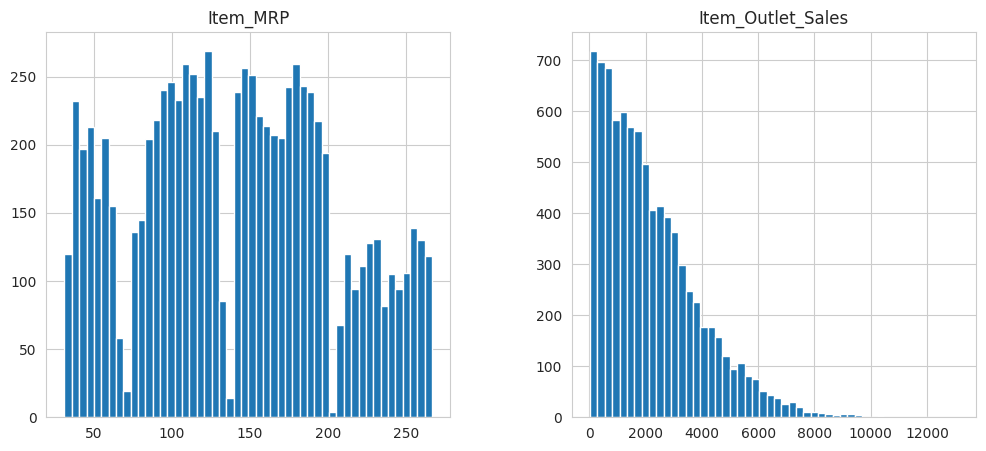

In [14]:
# Visualizing the distribution of 'Item_MRP' and 'Item_Outlet_Sales'
df1[['Item_MRP', 'Item_Outlet_Sales']].hist(bins=50, figsize=(12, 5))
plt.show()

# Why: To check for skewness, understand the distribution, and identify outliers in these key columns.

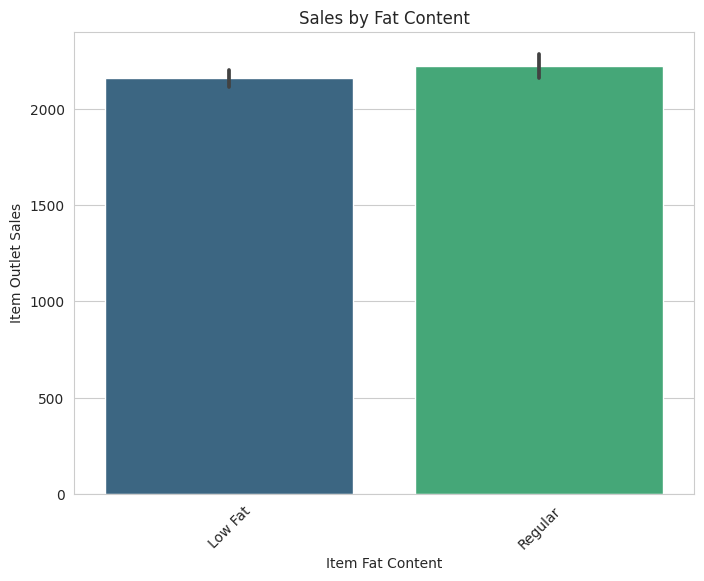

In [15]:
#Sales by Fat Content
plt.figure(figsize=(8, 6))
sns.barplot(x='Item_Fat_Content', y='Item_Outlet_Sales', data=df1, palette='viridis')
plt.title('Sales by Fat Content')
plt.ylabel('Item Outlet Sales')
plt.xlabel('Item Fat Content')
plt.xticks(rotation=45)
plt.show()

Looking at the sales by fat content, we see that regular fat content products have slightly higher sales but not too much

<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


Now I looked at the sales based on the stores age considering stores that have been around tend to have loyal customers but again customers tend to be drawn to newer and shinier establishments

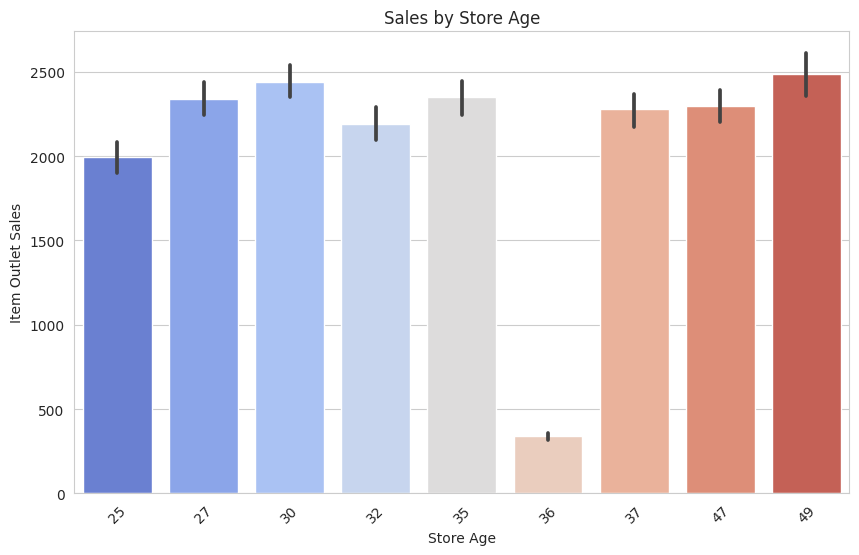

In [16]:
df1['Store_Age'] = 2034 - df1['Outlet_Establishment_Year']
df2['Store_Age'] = 2034 - df2['Outlet_Establishment_Year']

# 3. Sales by Store Age
plt.figure(figsize=(10, 6))
sns.barplot(x='Store_Age', y='Item_Outlet_Sales', data=df1, palette='coolwarm')
plt.title('Sales by Store Age')
plt.ylabel('Item Outlet Sales')
plt.xlabel('Store Age')
plt.xticks(rotation=45)
plt.show()

<div style="margin-bottom: 20px;"></div>


Next I considered the supermarket type versus the sales, the structure or type might have an effect on drawing customers and as a result better sales

from the results we can see that the stores age doesn't play a huge factor in terms of sales, indeed the oldest store has the highest sales but even the ones that have been around for fewer years are not far behind in terms of sales, we see stores that have been around for between 25-29 years outperforming and matching those from the 30-49 range

<div style="margin-bottom: 20px;"></div>


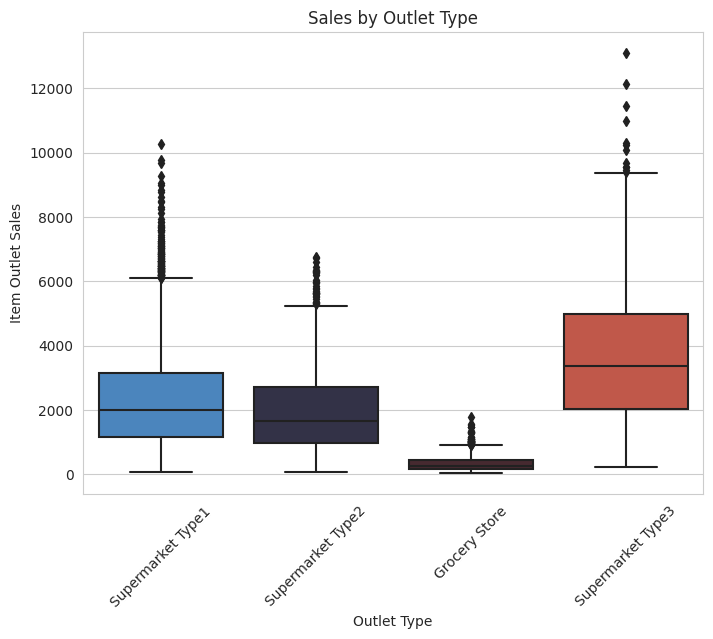

In [17]:
# 5. Sales by Outlet Type
plt.figure(figsize=(8, 6))
sns.boxplot(x='Outlet_Type', y='Item_Outlet_Sales', data=df1, palette='icefire')
plt.title('Sales by Outlet Type')
plt.ylabel('Item Outlet Sales')
plt.xlabel('Outlet Type')
plt.xticks(rotation=45)
plt.show()


From here we can see that the type 3 supermarket yields the highest outlet sales, followed bt type 1 and with grocery stores having the lowest sales

<div style="margin-bottom: 20px;"></div>


Another variable I looked at was the item visibilty, Item visibility in supermarkets refers to how easily customers can notice, access, and locate products on store shelves. Factors affecting visibility include shelf placement, facing, placement in high-traffic areas, signage, packaging, product arrangement, and stock availability. Optimizing item visibility is essential for driving sales and enhancing the shopping experience.

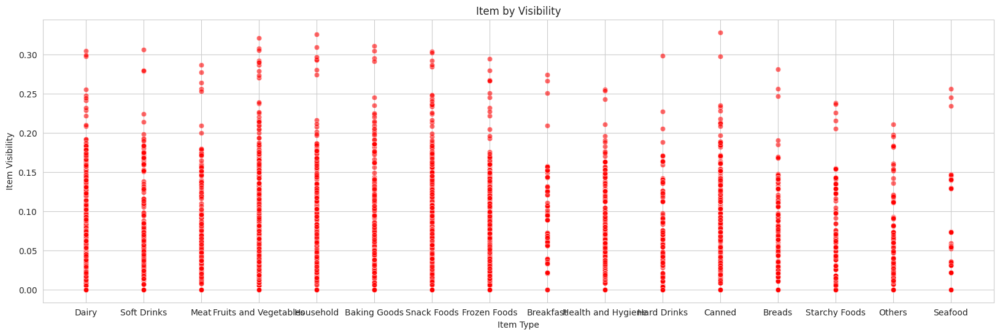

In [18]:
# 2. Sales by Visibility
plt.figure(figsize=(20, 6))
sns.scatterplot(x='Item_Type', y='Item_Visibility', data=df1, color='red', alpha=0.6)
plt.title('Item by Visibility')
plt.ylabel('Item Visibility')
plt.xlabel('Item Type')
plt.show()

The difference in the items visibility for the products is not that big which would suggest there is fair product placement , next I will take a look at how this affects sales

<ipython-input-22-8114f8ca25ae>:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=df1, x="Item_Visibility", y="Item_Type", hue="Outlet_Type", ci=None)


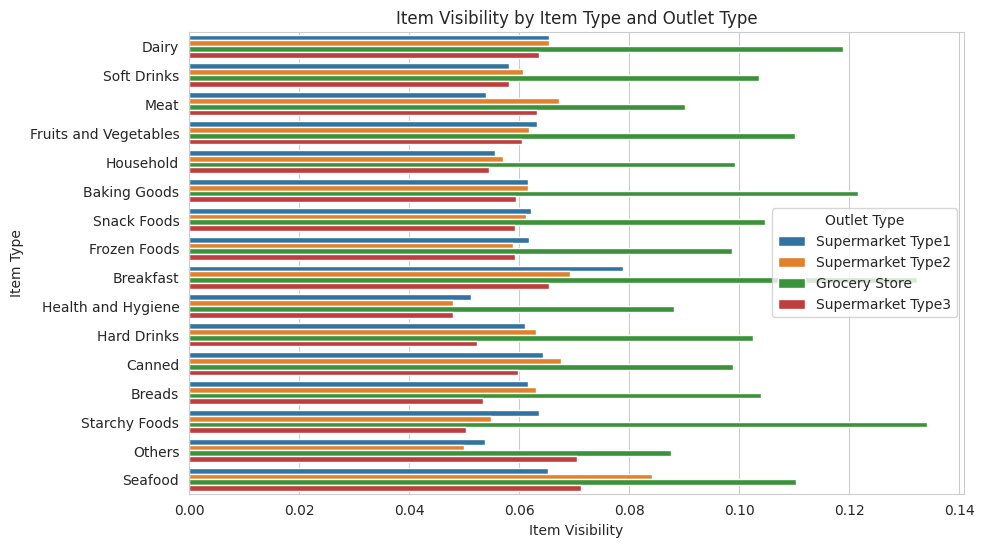

In [22]:

# Create the bar plot
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
sns.barplot(data=df1, x="Item_Visibility", y="Item_Type", hue="Outlet_Type", ci=None)

# Add labels and title
plt.xlabel("Item Visibility")
plt.ylabel("Item Type")
plt.title("Item Visibility by Item Type and Outlet Type")

# Show legend
plt.legend(title="Outlet Type")

# Show the plot
plt.show()

The barplot shows that grocery stores put more effort or rather items in grocery store settings have a higher visibility compared to the others, quite interesting considering how grocery stores had the lowest sales compared to the rest, this would requre further analysis on item visibility and its affect on an items sales

Sales by item type to check which items have the highest sales

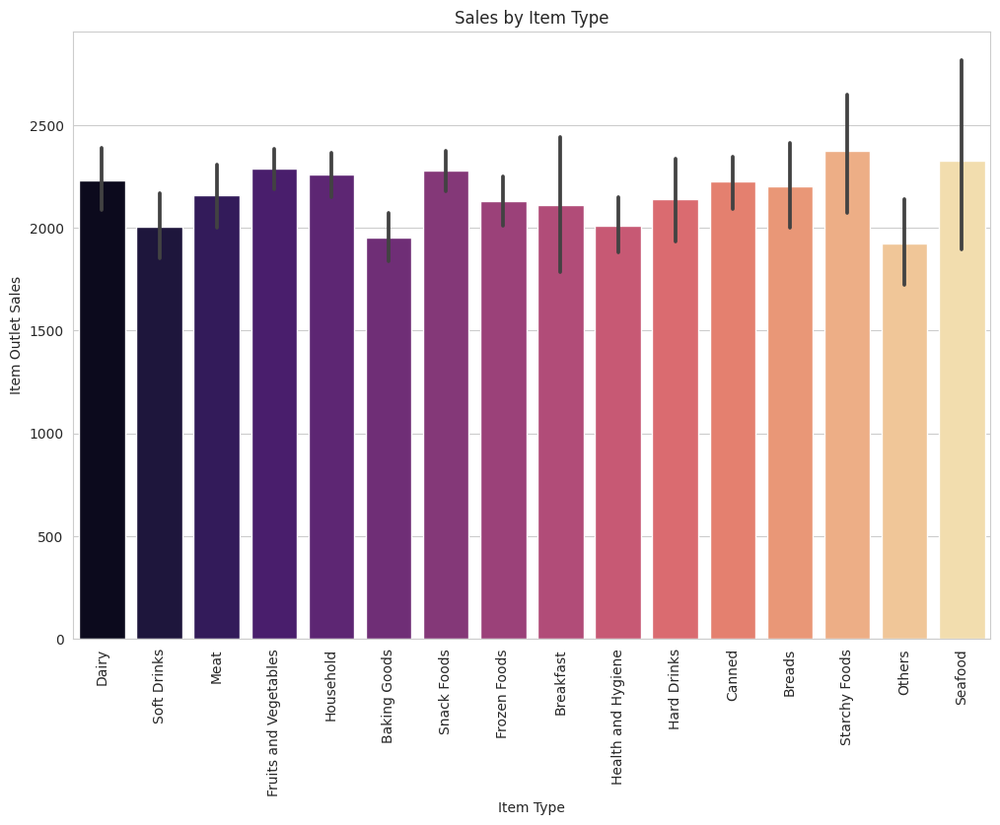

In [21]:
# 4. Sales by Item Type
plt.figure(figsize=(12, 8))
sns.barplot(x='Item_Type', y='Item_Outlet_Sales', data=df1, palette='magma')
plt.title('Sales by Item Type')
plt.ylabel('Item Outlet Sales')
plt.xlabel('Item Type')
plt.xticks(rotation=90)
plt.show()

Having determined sales by item, we need to also consider the items visibility per store type to get a view of how each store positions all the types of these products and how that will ulimately affect sales

<Figure size 1000x600 with 0 Axes>

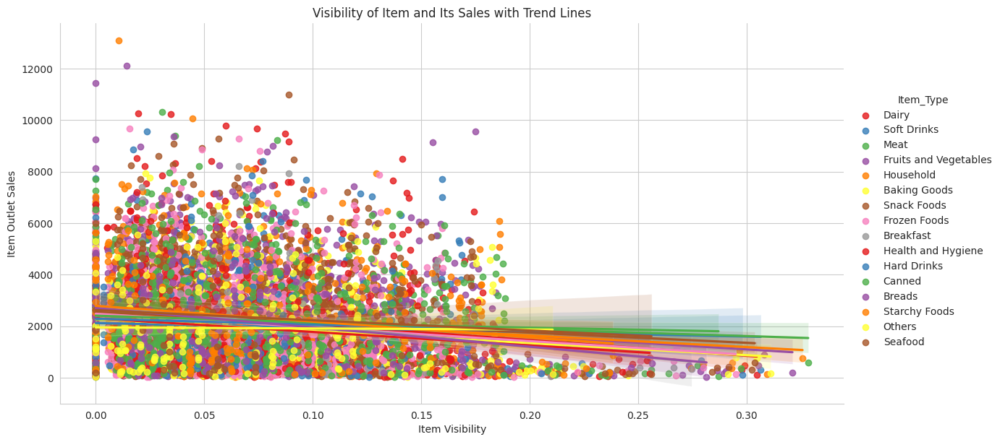

In [19]:
plt.figure(figsize=(10, 6))
sns.lmplot(x='Item_Visibility', y='Item_Outlet_Sales', hue='Item_Type', data=df1, palette='Set1', aspect=2, height=6)
plt.title('Visibility of Item and Its Sales with Trend Lines')
plt.ylabel('Item Outlet Sales')
plt.xlabel('Item Visibility')
plt.show()




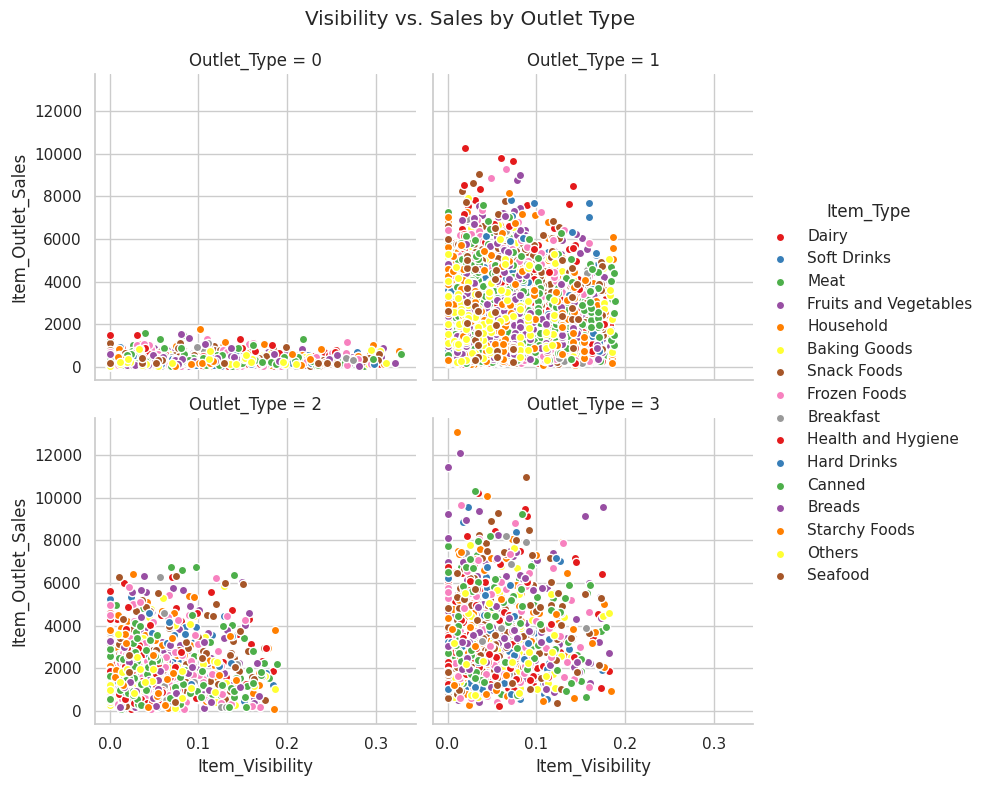

In [66]:
g = sns.FacetGrid(df1, col='Outlet_Type', hue='Item_Type', col_wrap=2, height=4, palette='Set1')
g = g.map(plt.scatter, 'Item_Visibility', 'Item_Outlet_Sales', edgecolor="w").add_legend()
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Visibility vs. Sales by Outlet Type ')
plt.show()


Mapping of Outlet Type indices to names:
0: Supermarket Type1
1: Supermarket Type2
2: Grocery Store
3: Supermarket Type3


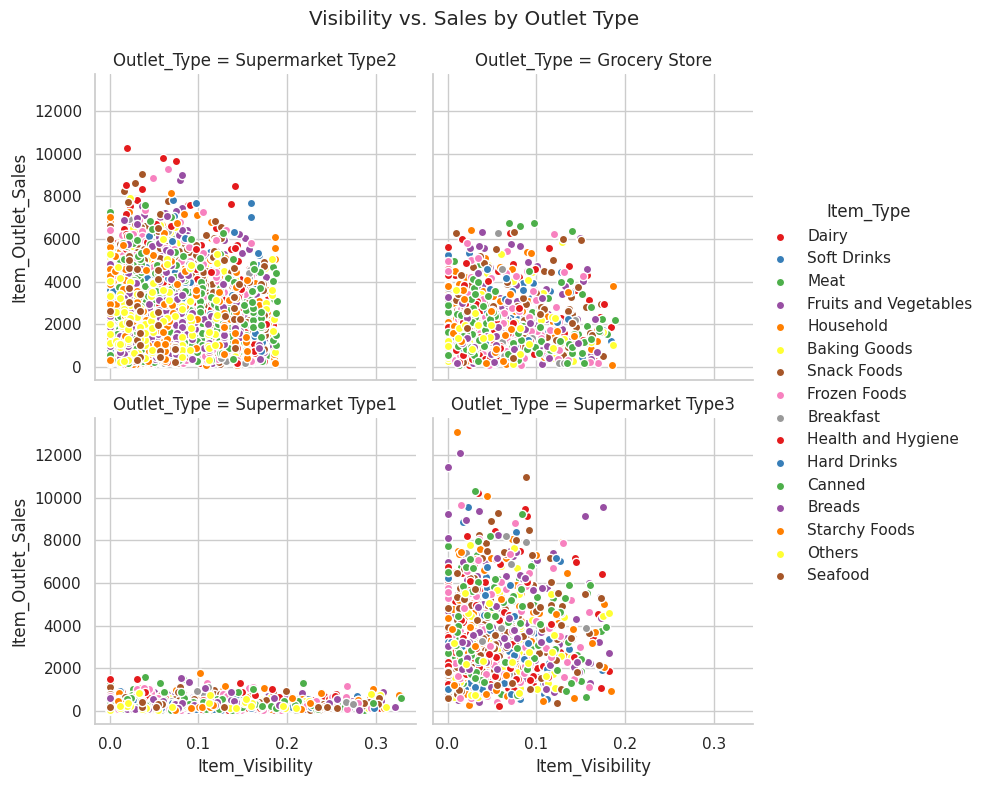

In [75]:
outlet_type_mapping = {0: 'Supermarket Type1', 1: 'Supermarket Type2', 2: 'Grocery Store', 3: 'Supermarket Type3'}
df1['Outlet_Type'] = df1['Outlet_Type'].map(outlet_type_mapping)

# Print the mapping for verification
print("Mapping of Outlet Type indices to names:")
for index, name in outlet_type_mapping.items():
    print(f"{index}: {name}")

# Create the FacetGrid
g = sns.FacetGrid(df1, col='Outlet_Type', hue='Item_Type', col_wrap=2, height=4, palette='Set1')
g = g.map(plt.scatter, 'Item_Visibility', 'Item_Outlet_Sales', edgecolor="w").add_legend()
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Visibility vs. Sales by Outlet Type')
plt.show()

I want to consider which items have the highest sales and which have the lowest sales for each store type, this is helpful in identifying products that can increase revenue, though a question would be posed, Is the revenue based on the popularity of th product or the price based on volume sold

In [23]:
# Highest selling item type for each store type
highest_sales_per_store = df1.loc[df1.groupby('Outlet_Type')['Item_Outlet_Sales'].idxmax()]

# Lowest selling item type for each store type
lowest_sales_per_store = df1.loc[df1.groupby('Outlet_Type')['Item_Outlet_Sales'].idxmin()]

# Highest visibility item type for each store type
highest_visibility_per_store = df1.loc[df1.groupby('Outlet_Type')['Item_Visibility'].idxmax()]

# Lowest visibility item type for each store type
lowest_visibility_per_store = df1.loc[df1.groupby('Outlet_Type')['Item_Visibility'].idxmin()]

# Displaying the results
print("Highest Selling Item Type for Each Store Type:")
print(highest_sales_per_store[['Outlet_Type', 'Item_Type', 'Item_Outlet_Sales']], '\n')

print("Lowest Selling Item Type for Each Store Type:")
print(lowest_sales_per_store[['Outlet_Type', 'Item_Type', 'Item_Outlet_Sales']], '\n')

print("Highest Visibility Item Type for Each Store Type:")
print(highest_visibility_per_store[['Outlet_Type', 'Item_Type', 'Item_Visibility']], '\n')

print("Lowest Visibility Item Type for Each Store Type:")
print(lowest_visibility_per_store[['Outlet_Type', 'Item_Type', 'Item_Visibility']])


Highest Selling Item Type for Each Store Type:
            Outlet_Type  Item_Type  Item_Outlet_Sales
7759      Grocery Store  Household          1775.6886
4888  Supermarket Type1      Dairy         10256.6490
43    Supermarket Type2     Canned          6768.5228
7188  Supermarket Type3  Household         13086.9648 

Lowest Selling Item Type for Each Store Type:
            Outlet_Type           Item_Type  Item_Outlet_Sales
906       Grocery Store         Soft Drinks            33.2900
2370  Supermarket Type1           Household            73.2380
5573  Supermarket Type2           Household            69.2432
239   Supermarket Type3  Health and Hygiene           241.6854 

Highest Visibility Item Type for Each Store Type:
            Outlet_Type  Item_Type  Item_Visibility
854       Grocery Store     Canned         0.328391
6175  Supermarket Type1     Canned         0.188620
632   Supermarket Type2     Canned         0.188323
7943  Supermarket Type3  Household         0.183948 

Lowest

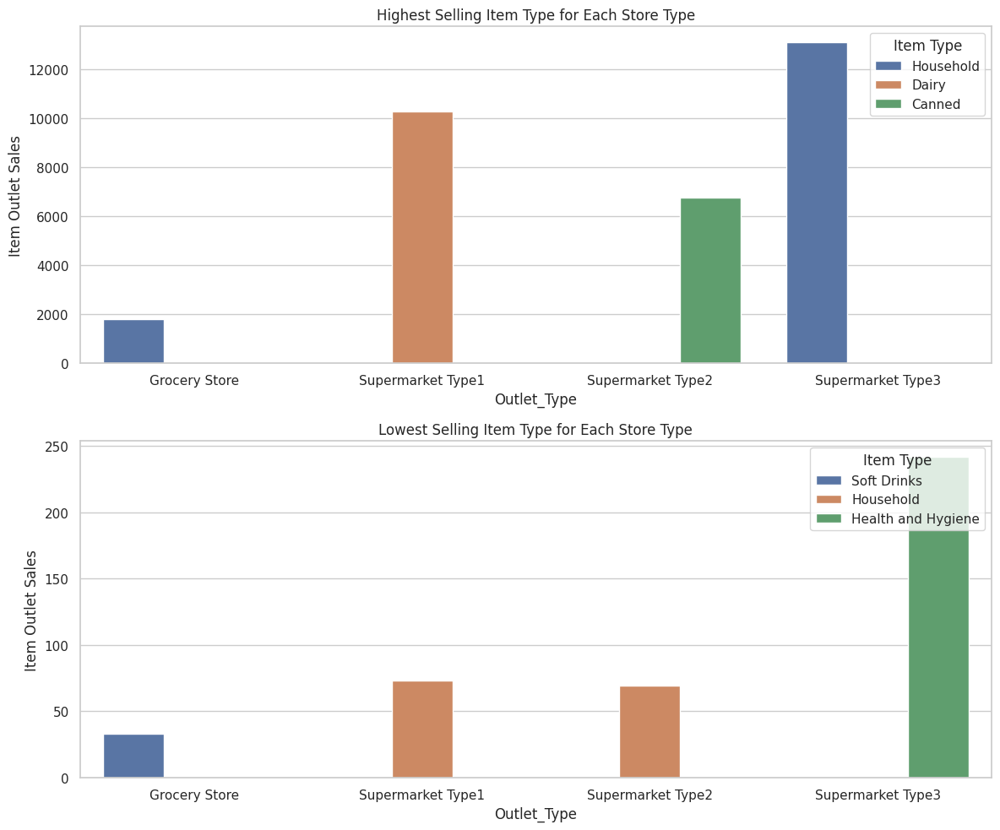

In [24]:
# Set style for seaborn plots
sns.set(style="whitegrid")

# Create a figure with subplots
fig, axes = plt.subplots(2, 1, figsize=(12, 10))

# Highest Selling Item Type for Each Store Type
sns.barplot(ax=axes[0], x='Outlet_Type', y='Item_Outlet_Sales', hue='Item_Type', data=highest_sales_per_store)
axes[0].set_title('Highest Selling Item Type for Each Store Type')
axes[0].set_ylabel('Item Outlet Sales')
axes[0].legend(title='Item Type', loc='upper right')

# Lowest Selling Item Type for Each Store Type
sns.barplot(ax=axes[1], x='Outlet_Type', y='Item_Outlet_Sales', hue='Item_Type', data=lowest_sales_per_store)
axes[1].set_title('Lowest Selling Item Type for Each Store Type')
axes[1].set_ylabel('Item Outlet Sales')
axes[1].legend(title='Item Type', loc='upper right')

plt.tight_layout()
plt.show()

Here we see which items have the highest and lowest sales for each type of store

<div style="margin-bottom: 20px;"></div>

<div style="margin-bottom: 20px;"></div>

In this section I move on to perform statisitcal analysis on the dataset, it is crucial because Statistical analysis is essential for understanding data characteristics, identifying patterns, testing hypotheses, building predictive models, making informed decisions, and improving quality. It helps in uncovering insights, validating findings, and supporting decision-making across various domains.

In [25]:
# Descriptive Statistics for Item_Outlet_Sales
sales_desc = df1['Item_Outlet_Sales'].describe()
print(sales_desc)

count     8523.000000
mean      2181.288914
std       1706.499616
min         33.290000
25%        834.247400
50%       1794.331000
75%       3101.296400
max      13086.964800
Name: Item_Outlet_Sales, dtype: float64


<div style="margin-bottom: 20px;"></div>

Here I will perform corelation analysis , Correlation analysis examines the strength and direction of relationships between variables in a dataset. The correlation coefficient, ranging from -1 to 1, indicates the degree of linear association between two variables:
A correlation coefficient close to 1 implies a strong positive relationship, meaning that as one variable increases, the other variable also tends to increase.
A correlation coefficient close to -1 indicates a strong negative relationship, suggesting that as one variable increases, the other variable tends to decrease.
A correlation coefficient near 0 suggests a weak or no linear relationship between the variables.

In [26]:
# Select only numerical columns for correlation analysis
numerical_df = df1.select_dtypes(include=['float64', 'int64'])
correlation_matrix = numerical_df.corr()
print(correlation_matrix['Item_Outlet_Sales'])

Item_Weight                  0.012088
Item_Visibility             -0.128625
Item_MRP                     0.567574
Outlet_Establishment_Year   -0.049135
Item_Outlet_Sales            1.000000
Store_Age                    0.049135
Name: Item_Outlet_Sales, dtype: float64


Item_Weight:

Very weak positive correlation (0.012) with Item_Outlet_Sales.
Item_Visibility:

Moderate negative correlation (-0.129) with Item_Outlet_Sales, suggesting that higher visibility tends to be associated with lower sales.
Item_MRP:

Moderate positive correlation (0.568) with Item_Outlet_Sales, indicating that higher maximum retail prices are associated with higher sales.
Outlet_Establishment_Year:

Very weak negative correlation (-0.049) with Item_Outlet_Sales, suggesting a slight decrease in sales over the years.
Store_Age (derived from Outlet_Establishment_Year):

Same weak negative correlation (-0.049) with Item_Outlet_Sales as Outlet_Establishment_Year.
Overall, the results indicate that Item_MRP has the strongest correlation with Item_Outlet_Sales among the variables listed. This suggests that pricing strategy plays a significant role in influencing sales. Additionally, Item_Visibility shows a notable negative correlation, indicating the potential impact of product visibility on sales, although other factors may also contribute to this relationship. The correlations for Item_Weight and Outlet_Establishment_Year/Store_Age are very weak, suggesting minimal linear association with sales.

<div style="margin-bottom: 20px;"></div>

Distribution analysis involves examining how data is spread out across different ranges. It helps identify patterns, outliers, and skewness in the data, informing further analysis and decision-making. By understanding the distribution of variables, we can select appropriate statistical methods, models, and transformations for analysis, ultimately extracting meaningful insights from the data.

<Axes: xlabel='Item_Outlet_Sales', ylabel='Count'>

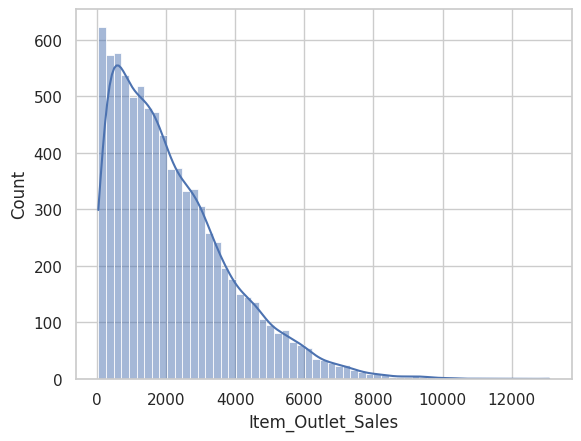

In [27]:
# Distribution Analysis of Item_Outlet_Sales
sns.histplot(df1['Item_Outlet_Sales'], kde=True)

# Interpretation:
# - A symmetric distribution suggests balanced sales.
# - Skewness indicates bias towards lower or higher sales.
# - KDE curve helps understand the shape of distribution.

<Axes: xlabel='Item_Outlet_Sales'>

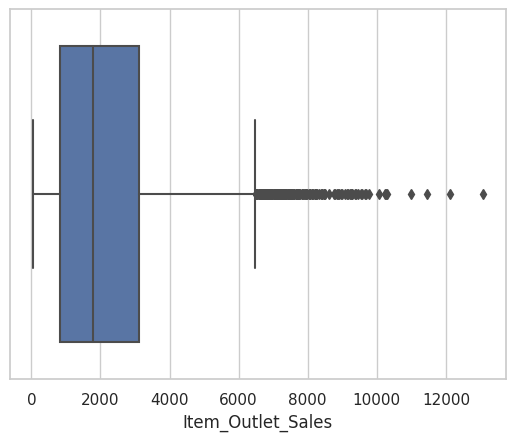

In [28]:
sns.boxplot(x=df1['Item_Outlet_Sales'])

# Interpretation:
# - Points beyond the whiskers in the boxplot indicate outliers.
# - Identifying outliers is crucial for understanding sales extremes and data quality.


In [29]:
# Grouped Analysis by Outlet_Type
grouped_sales_outlet_type = df1.groupby('Outlet_Type')['Item_Outlet_Sales'].mean()
print(grouped_sales_outlet_type)

# Interpretation:
# This analysis provides average sales figures for each type of outlet, helping identify which outlet type performs best.

Outlet_Type
Grocery Store         339.828500
Supermarket Type1    2316.181148
Supermarket Type2    1995.498739
Supermarket Type3    3694.038558
Name: Item_Outlet_Sales, dtype: float64


Grocery Stores have the lowest sales, with an average of approximately 340 units.

Supermarket Type1 has the second-highest sales, with an average of around 2316 units.

Supermarket Type2 follows with an average of approximately 1995 units.

Supermarket Type3 has the highest average sales among the types, with around 3694 units.


This suggests that Supermarket Type3 tends to have significantly higher sales compared to other types of outlets, while Grocery Stores have the lowest sales on average.

This is an observation made earlier on

I'm conducting a statistical hypothesis test,  to determine if there's a significant difference between two groups. The T-statistic measures the size of the difference relative to the variation in the data, and a larger absolute value indicates a larger difference between the groups. The P-value indicates the probability of observing the results if there's no difference between the groups. In this case, the negative T-statistic and extremely small P-value (reported as 0.0) suggest a significant difference between the groups, with high confidence.

In [30]:
# Assuming you have two types of outlets: 'Grocery Store' and 'Supermarket Type1'
group1 = df1[df1['Outlet_Type'] == 'Grocery Store']['Item_Outlet_Sales']
group2 = df1[df1['Outlet_Type'] == 'Supermarket Type1']['Item_Outlet_Sales']

# Perform T-Test
t_stat, p_val = ttest_ind(group1, group2, equal_var=False)
print(f"T-Statistic: {t_stat}, P-value: {p_val}")

# Interpretation:
# - A low p-value (typically < 0.05) indicates strong evidence against the null hypothesis, so you reject the null hypothesis.
# - A high p-value (> 0.05) suggests weak evidence against the null hypothesis, so you fail to reject the null hypothesis.

T-Statistic: -90.69030728312184, P-value: 0.0


The results say there's a big difference between the two groups. The chance of this difference happening randomly is almost zero. So, it seems like the groups are really different from each other.

ANOVA, or Analysis of Variance, is a statistical tool used to compare means across multiple groups. It's valuable for determining if there are significant differences between group means. ANOVA helps efficiently analyze data from various groups simultaneously, aiding in identifying factors that influence outcomes and guiding decision-making in various fields.

In [31]:
# Dynamically generating groups for ANOVA
outlet_types = df1['Outlet_Type'].unique()  # Extracts all unique outlet types from your DataFrame
groups = [df1[df1['Outlet_Type'] == outlet]['Item_Outlet_Sales'] for outlet in outlet_types]

# Perform ANOVA
f_stat, p_val = f_oneway(*groups)
print(f"F-Statistic: {f_stat}, P-value: {p_val}")

# Interpretation:
# - An F-Statistic value indicates the ratio of variance between the groups to the variance within the groups.
# - A low p-value (<0.05) suggests that there are significant differences in the average sales across different outlet types,
#   meaning at least one outlet type's average sales differ significantly from the others.

F-Statistic: 894.6500119018012, P-value: 0.0


These results indicate a highly significant difference in sales among the different outlet types. The F-statistic of 894.65 suggests a large variation between group means compared to within-group variation. Additionally, the very low P-value (0.0) implies that this difference is highly unlikely to have occurred by random chance alone. Overall, the findings suggest that the outlet types have significantly different sales performance.

Here I perform the Chi-square test, The Chi-Square test helps determine if there's a significant association between two categorical variables. It can reveal whether there's a relationship between 'Outlet_Location_Type' and 'Outlet_Size', which is valuable for understanding patterns in categorical data.

In [32]:
# Creating a contingency table of the frequencies of Outlet_Location_Type and Outlet_Size
contingency_table = pd.crosstab(df1['Outlet_Location_Type'], df1['Outlet_Size'])

# Performing the Chi-Square Test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Squared Value: {chi2}")
print(f"P-Value: {p_value}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies:")
print(expected)

# Interpretation
if p_value < 0.05:
    print("There is a significant association between Outlet Location Type and Outlet Size.")
else:
    print("There is no significant association between Outlet Location Type and Outlet Size.")


''' Explanation:
Chi-Squared Value: This is the test statistic. A higher value indicates a greater discrepancy between observed and expected frequencies under the null hypothesis of independence.
P-Value: This indicates the probability of observing the data if the null hypothesis is true. A low p-value (typically < 0.05) suggests rejecting the null hypothesis, implying a significant association between the variables.
Degrees of Freedom: This is calculated based on the number of levels in each categorical variable. It's used in determining the critical value from the chi-square distribution.
Expected Frequencies: These are the frequencies expected in each category combination if there were no association between the variables.'''

Chi-Squared Value: 4806.778592709207
P-Value: 0.0
Degrees of Freedom: 4
Expected Frequencies:
[[ 261.13058782  782.55121436 1344.31819782]
 [ 304.54300129  912.64871524 1567.80828347]
 [ 366.32641089 1097.8000704  1885.87351871]]
There is a significant association between Outlet Location Type and Outlet Size.


" Explanation:\nChi-Squared Value: This is the test statistic. A higher value indicates a greater discrepancy between observed and expected frequencies under the null hypothesis of independence.\nP-Value: This indicates the probability of observing the data if the null hypothesis is true. A low p-value (typically < 0.05) suggests rejecting the null hypothesis, implying a significant association between the variables.\nDegrees of Freedom: This is calculated based on the number of levels in each categorical variable. It's used in determining the critical value from the chi-square distribution.\nExpected Frequencies: These are the frequencies expected in each category combination if there were no association between the variables."

<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


Here I will start with the modelling,first I have to preprocess the data

> Add blockquote

> Add blockquote

> Add blockquote







In [33]:
'''
Label encoding converts categorical data into numerical format by assigning each category a unique integer label.
 It's important for preparing categorical data for machine learning algorithms, enabling them to process and analyze the data.
 However, it's essential to be mindful of potential ordinality introduced by label encoding
'''

# Initialize label encoder
label_encoder = LabelEncoder()

# Fit on the training data and transform both training and test data
df1['Outlet_Type_Encoded'] = label_encoder.fit_transform(df1['Outlet_Type'])
df2['Outlet_Type_Encoded'] = label_encoder.transform(df2['Outlet_Type'])

In [34]:
# Calculate the mean visibility per item
visibility_avg = df1[df1['Item_Visibility'] > 0].groupby('Item_Identifier')['Item_Visibility'].mean()

# Function to adjust item visibility
def adjust_visibility(row):
    if row['Item_Visibility'] == 0:
        return visibility_avg[row['Item_Identifier']]
    return row['Item_Visibility']

# Apply function to both training and test sets
df1['Adjusted_Item_Visibility'] = df1.apply(adjust_visibility, axis=1)
df2['Adjusted_Item_Visibility'] = df2.apply(adjust_visibility, axis=1)

In [35]:
# Print unique values in Item_Visibility
unique_item_visibility = df1['Item_Visibility'].unique()
print("Unique Item Visibility values:")
print(unique_item_visibility)

# Print unique values in Item_MRP
unique_item_mrp = df1['Item_MRP'].unique()
print("\nUnique Item MRP values:")
print(unique_item_mrp)

Unique Item Visibility values:
[0.0160473  0.01927822 0.01676007 ... 0.03518627 0.14522065 0.04487828]

Unique Item MRP values:
[249.8092  48.2692 141.618  ...  57.5904 214.5218  75.467 ]


In [36]:
"""
Binning is important for columns with numerous distinct values as it simplifies the data,
making it easier to interpret and analyze. By grouping values into bins or categories,
we can identify patterns more effectively, improve model performance, and enhance interpretability of results. Additionally,
binning helps address issues such as overfitting and multicollinearity in statistical models.
Overall, binning is a valuable preprocessing step for managing and understanding data with a large number of different values.

"""


# Binning for Item_Visibility
visibility_bins = [0, 0.05, 0.1, 0.15, np.inf]
visibility_labels = ['Low', 'Medium', 'High', 'Very High']
df1['Item_Visibility_Bin'] = pd.cut(df1['Item_Visibility'], bins=visibility_bins, labels=visibility_labels, right=False)
df2['Item_Visibility_Bin'] = pd.cut(df2['Item_Visibility'], bins=visibility_bins, labels=visibility_labels, right=False)

# Binning for Item_MRP
mrp_bins = df1['Item_MRP'].quantile([0, 0.25, 0.5, 0.75, 1]).values
mrp_labels = ['Low', 'Medium', 'High', 'Very High']
df1['Item_MRP_Bin'] = pd.cut(df1['Item_MRP'], bins=mrp_bins, labels=mrp_labels)
df2['Item_MRP_Bin'] = pd.cut(df2['Item_MRP'], bins=mrp_bins, labels=mrp_labels)

# Displaying the head of the adjusted DataFrames to verify changes
print("Training Set Adjustments:")
print(df1[['Item_Visibility', 'Item_Visibility_Bin', 'Item_MRP', 'Item_MRP_Bin']].head())

print("\nTest Set Adjustments:")
print(df2[['Item_Visibility', 'Item_Visibility_Bin', 'Item_MRP', 'Item_MRP_Bin']].head())

Training Set Adjustments:
   Item_Visibility Item_Visibility_Bin  Item_MRP Item_MRP_Bin
0         0.016047                 Low  249.8092    Very High
1         0.019278                 Low   48.2692          Low
2         0.016760                 Low  141.6180       Medium
3         0.000000                 Low  182.0950         High
4         0.000000                 Low   53.8614          Low

Test Set Adjustments:
   Item_Visibility Item_Visibility_Bin  Item_MRP Item_MRP_Bin
0         0.007565                 Low  107.8622       Medium
1         0.038428                 Low   87.3198          Low
2         0.099575              Medium  241.7538    Very High
3         0.015388                 Low  155.0340         High
4         0.118599                High  234.2300    Very High


In [37]:
"""
The code uses scikit-learn's LabelEncoder to convert categorical data into numerical format by assigning unique integer labels to each category.
It replaces the original categorical data with these numerical labels,
making it suitable for machine learning algorithms that require numerical input.

"""

# Initialize label encoder
label_encoder = LabelEncoder()

# List of categorical columns to encode
categorical_cols = ['Item_Fat_Content', 'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type']

# Encode categorical columns
for col in categorical_cols:
    df1[col] = label_encoder.fit_transform(df1[col])
    df2[col] = label_encoder.transform(df2[col])  # Ensure the same encoding on test data

# Separating the features and target variable
X_train = df1.drop(columns=['Item_Outlet_Sales','Item_Identifier','Item_Type','Outlet_Identifier', 'Item_Visibility_Bin','Item_MRP_Bin'])
y_train = df1['Item_Outlet_Sales']

#  df2 does not include the target variable
X_test = df2.drop(columns=['Item_Identifier','Item_Type','Outlet_Identifier', 'Item_Visibility_Bin','Item_MRP_Bin'])

<div style="margin-bottom: 20px;"></div>


<div style="margin-bottom: 20px;"></div>


For modelling I decided on 4 models,The models were selected  based on their ability to handle various aspects of the data: Linear Regression for baseline simplicity, Random Forest for handling non-linearity and feature importance, XGBoost for performance and efficient boosting, and LightGBM for fast training and memory efficiency.

In [65]:
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest': RandomForestRegressor(),
    'XGBoost': XGBRegressor(objective='reg:squarederror'),
    'LightGBM': LGBMRegressor()
}

# Function to evaluate models
def evaluate_models(models, X_train, y_train):
    """
    Evaluate a dictionary of regression models using cross-validation.

    Parameters:
    - models (dict): A dictionary containing regression model instances.
    - X_train (array-like): Training input samples.
    - y_train (array-like): Target values.

    Returns:
    None
    """
    for name, model in models.items():
        model.fit(X_train, y_train)
        scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
        rmse_scores = np.sqrt(-scores)
        print(f"{name} Average RMSE: {np.mean(rmse_scores)}")

# Evaluate models
evaluate_models(models, X_train, y_train)

Linear Regression Average RMSE: 1206.3336316321024
Random Forest Average RMSE: 1147.400413712028
XGBoost Average RMSE: 1191.6431464686696
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1035
[LightGBM] [Info] Number of data points in the train set: 8523, number of used features: 11
[LightGBM] [Info] Start training from score 2181.288915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1036
[LightGBM] [Info] Number of data points in the train set: 6818, number of used features: 11
[LightGBM] [Info] Start training from score 2172.545146
[LightGBM] [Info] Auto-choosing row-wise multi

we see from the results that the best performing model is the LightGBM with the lowesr RSME, so I will select it as the best model and do hyperparameter tuning to make it perform better

In [40]:
"""
This script encapsulates the comprehensive workflow of developing a predictive model, focusing on sales prediction based on item and outlet features. Our approach starts with preliminary data processing, advances through model selection, hyperparameter tuning, and concludes with model evaluation. Each step is integral to the development of a robust predictive model.

Initial Data Processing:
Prior to model training, we meticulously prepared our dataset by encoding categorical variables, imputing missing values, and selecting relevant features. This preprocessing stage laid the foundation for developing a reliable predictive model by ensuring our data is in the right format and of high quality.

Starting with Hyperparameter Tuning:
Given the dataset's prepared state, we initiate this script with hyperparameter tuning, recognizing its pivotal role in enhancing model performance. By employing GridSearchCV, we explore a range of parameter combinations for our chosen model - LightGBM (Light Gradient Boosting Machine), a decision that stems from LightGBM's efficiency and effectiveness across diverse datasets. This systematic search allows us to identify the optimal model configuration, significantly influencing our model's predictive accuracy.

Training the Optimized Model:
Armed with the best set of hyperparameters, we proceed to train our LightGBM model on the entire training set. This step is crucial as it leverages the insights gained from tuning to build a model that is finely adjusted to our specific prediction task.

Model Evaluation and Application:
Finally, we employ the optimized model to predict sales on unseen data, aiming to gauge its practical utility. While this script primarily focuses on prediction, in a comprehensive analysis, one would compare these predictions against actual sales figures to evaluate the model's performance quantitatively. The ultimate goal is to harness these predictions to derive actionable insights that can inform business strategies.

In essence, this script is a testament to the methodical process of building a predictive model from data preprocessing to application. It underscores the importance of each step in the pipeline, especially hyperparameter tuning, in crafting a model that is not only theoretically sound but also practically valuable.
"""


# Define the parameter grid
param_grid = {
    'num_leaves': [31, 127],
    'reg_alpha': [0.1, 0.5],
    'min_data_in_leaf': [30, 50, 100, 300, 400],
    'lambda_l1': [0, 1, 1.5],
    'lambda_l2': [0, 1]
}

# Initialize the model
lgbm = LGBMRegressor(random_state=42)

# Initialize the Grid Search model
grid_search = GridSearchCV(estimator=lgbm, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)

# Fit the model on training data
grid_search.fit(X_train, y_train)

# Print the best parameters found by Grid Search
print("Best parameters found: ", grid_search.best_params_)

# Initialize the model with the best parameters
lgbm_final = LGBMRegressor(**grid_search.best_params_)

# Fit the final model on the training data
lgbm_final.fit(X_train, y_train)

# Make predictions on the test data
predictions = lgbm_final.predict(X_test)

# Assuming 'Item_Outlet_Sales' is the target in df1 and df2 doesn't contain this column
# Create a DataFrame for the predictions for easy visualization
predictions_df = pd.DataFrame(predictions, columns=['Predicted_Sales'])

# Reset index on df1 to align it with predictions for side-by-side comparison
df1_reset = df1.reset_index(drop=True)
predictions_df_reset = predictions_df.reset_index(drop=True)

# Combine actual sales from df1 with predicted sales for comparison
comparison_df = pd.concat([df1_reset, predictions_df_reset], axis=1)

# Optionally, display a few rows to check the comparison
print(comparison_df[['Item_Identifier', 'Item_Outlet_Sales', 'Predicted_Sales']].head())

Fitting 5 folds for each of 120 candidates, totalling 600 fits
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l2 is set=1, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.1 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] lambda_l2 is set=1, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.1 will be ignored. Current value: lambda_l1=0
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1035
[LightGBM] [Info] Number of dat

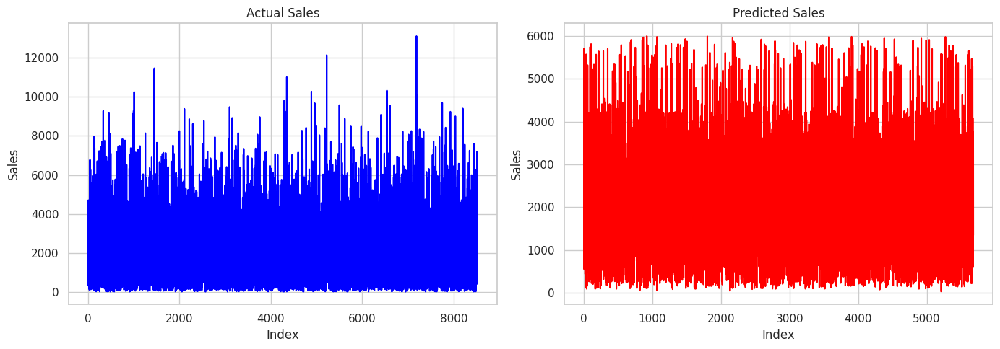

In [41]:
# Converting predictions to a DataFrame for easier handling
predictions_df = pd.DataFrame(predictions, columns=['Predicted_Sales'])

# Now, we're going to make two plots side by side for a clear visual comparison
fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Plotting actual sales from df1 on the first subplot
sns.lineplot(data=df1['Item_Outlet_Sales'].reset_index(drop=True), ax=axs[0], color='blue')
axs[0].set_title('Actual Sales')
axs[0].set_ylabel('Sales')
axs[0].set_xlabel('Index')

# Plotting predicted sales on the second subplot
sns.lineplot(data=predictions_df['Predicted_Sales'], ax=axs[1], color='red')
axs[1].set_title('Predicted Sales')
axs[1].set_ylabel('Sales')
axs[1].set_xlabel('Index')

plt.tight_layout()
plt.show()

# So here's what we've done: We created two subplots to visually compare the actual sales figures
# from our dataset with the sales figures our model predicted. The first plot shows the actual sales
# in blue, and the second plot shows our model's predictions in red.
# This side-by-side comparison helps us get a quick visual sense of how well our model's predictions
# align with the actual sales data. Though this won't give us exact figures or metrics like RMSE,
# it's a good starting point for visual analysis.


From the visuals It is seen that the model doesn't perform really well as the predicted sales are way higher than the actual sales, suggesting overfitting

To help improve the model, I will perform cross validation, Cross-validation is a technique used to assess the performance of a machine learning model by splitting the dataset into multiple subsets. It helps to estimate how well the model will generalize to unseen data by training and testing the model on different subsets iteratively. This helps to mitigate issues such as overfitting and provides a more reliable evaluation of the model's performance.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1036
[LightGBM] [Info] Number of data points in the train set: 6818, number of used features: 11
[LightGBM] [Info] Start training from score 2172.545146
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1034
[LightGBM] [Info] Number of data points in the train set: 6818, number of used features: 11
[LightGBM] [Info] Start training from score 2191.214108
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Tota

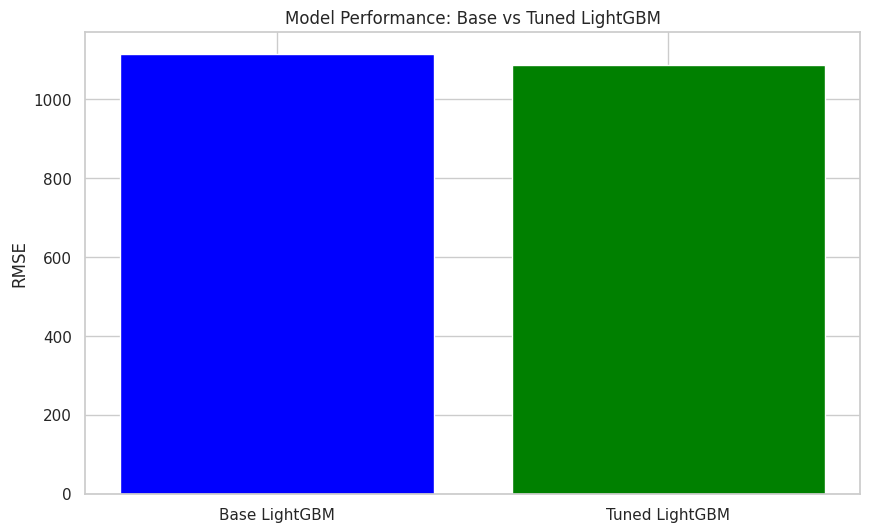

In [42]:
# Initialize the base LightGBM model
lgbm_base = LGBMRegressor()

# Perform cross-validation on the base model
cv_scores_base = cross_val_score(lgbm_base, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
cv_rmse_scores_base = np.sqrt(-cv_scores_base)

print(f"Base LightGBM Cross-validated RMSE: {np.mean(cv_rmse_scores_base)}")

# Now, for the tuned model:
cv_scores_tuned = cross_val_score(lgbm_final, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
cv_rmse_scores_tuned = np.sqrt(-cv_scores_tuned)

print(f"Tuned LightGBM Cross-validated RMSE: {np.mean(cv_rmse_scores_tuned)}")

# Visualization
plt.figure(figsize=(10, 6))
plt.bar(['Base LightGBM', 'Tuned LightGBM'], [np.mean(cv_rmse_scores_base), np.mean(cv_rmse_scores_tuned)], color=['blue', 'green'])
plt.ylabel('RMSE')
plt.title('Model Performance: Base vs Tuned LightGBM')
plt.show()

Here we see that even after cross validation, the base model performs better than the tuned LightGBM model

To improve the model, I considered Random search,
Random search is a method used for hyperparameter optimization in machine learning models. It involves randomly sampling the hyperparameter space and evaluating the model's performance for each set of hyperparameters. Unlike grid search, which evaluates all possible combinations, random search selects hyperparameters randomly within specified ranges. This approach can be more efficient and effective, especially when the hyperparameter space is large, as it focuses computational resources on areas more likely to yield good results.

In [43]:
# Step 1: Random Search to explore a broad range of values
random_param_grid = {
    'num_leaves': np.random.randint(20, 150, 5),
    'reg_alpha': np.random.uniform(0, 1, 5),
    'min_data_in_leaf': np.random.randint(20, 500, 5),
    'lambda_l1': np.random.uniform(0, 2, 5),
    'lambda_l2': np.random.uniform(0, 2, 5)
}

# Initialize the model
lgbm_random = LGBMRegressor(random_state=42)

# Initialize Random Search model
random_search = RandomizedSearchCV(estimator=lgbm_random, param_distributions=random_param_grid,
                                   n_iter=100, cv=5, scoring='neg_mean_squared_error',
                                   n_jobs=-1, verbose=1, random_state=42)

# Fit the model
random_search.fit(X_train, y_train)

# Print the best parameters found by Random Search
print("Best parameters found by Random Search: ", random_search.best_params_)

# Step 2: Grid Search within a focused range based on Random Search results
focused_param_grid = {
    'num_leaves': [random_search.best_params_['num_leaves'] - 10, random_search.best_params_['num_leaves'], random_search.best_params_['num_leaves'] + 10],
    'reg_alpha': [max(0, random_search.best_params_['reg_alpha'] - 0.1), random_search.best_params_['reg_alpha'], random_search.best_params_['reg_alpha'] + 0.1],
    'min_data_in_leaf': [random_search.best_params_['min_data_in_leaf'] - 50, random_search.best_params_['min_data_in_leaf'], random_search.best_params_['min_data_in_leaf'] + 50],
    'lambda_l1': [max(0, random_search.best_params_['lambda_l1'] - 0.5), random_search.best_params_['lambda_l1'], random_search.best_params_['lambda_l1'] + 0.5],
    'lambda_l2': [max(0, random_search.best_params_['lambda_l2'] - 0.5), random_search.best_params_['lambda_l2'], random_search.best_params_['lambda_l2'] + 0.5]
}

# Initialize the model
lgbm_grid = LGBMRegressor(random_state=42)

# Initialize the Grid Search model
grid_search = GridSearchCV(estimator=lgbm_grid, param_grid=focused_param_grid, cv=5,
                           scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)

# Fit the model on training data refined by Random Search
grid_search.fit(X_train, y_train)

# Print the best parameters found by Grid Search
print("Best parameters found by Grid Search: ", grid_search.best_params_)

# Initialize the final model with the best parameters
lgbm_final = LGBMRegressor(**grid_search.best_params_)
lgbm_final.fit(X_train, y_train)

# Make predictions on the test data
predictions = lgbm_final.predict(X_test)

# Assuming 'Item_Outlet_Sales' is the target in df1 and df2 doesn't contain this column
# Here, 'predictions' are the sales predicted by the final model


Fitting 5 folds for each of 100 candidates, totalling 500 fits
[LightGBM] [Warning] min_data_in_leaf is set=354, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=354
[LightGBM] [Warning] lambda_l2 is set=0.37345424518903414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37345424518903414
[LightGBM] [Warning] lambda_l1 is set=0.9198929559394207, reg_alpha=0.14259878654976244 will be ignored. Current value: lambda_l1=0.9198929559394207
[LightGBM] [Warning] min_data_in_leaf is set=354, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=354
[LightGBM] [Warning] lambda_l2 is set=0.37345424518903414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37345424518903414
[LightGBM] [Warning] lambda_l1 is set=0.9198929559394207, reg_alpha=0.14259878654976244 will be ignored. Current value: lambda_l1=0.9198929559394207
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000615 seconds.
You can set `fo

In [44]:
# Making predictions with the tuned model
final_predictions = lgbm_final.predict(X_test)


[LightGBM] [Warning] min_data_in_leaf is set=354, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=354
[LightGBM] [Warning] lambda_l2 is set=0.37345424518903414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37345424518903414
[LightGBM] [Warning] lambda_l1 is set=0.9198929559394207, reg_alpha=0.04259878654976243 will be ignored. Current value: lambda_l1=0.9198929559394207


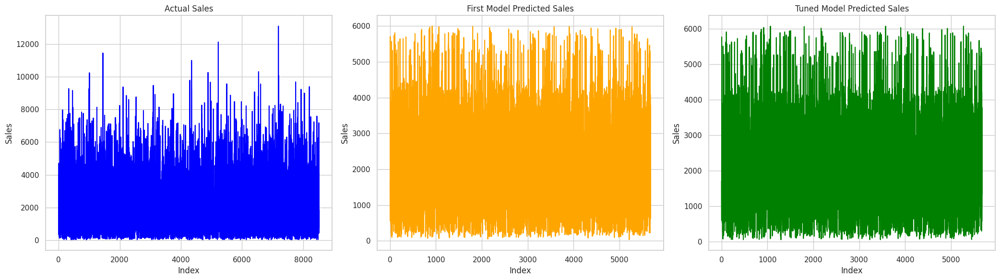

In [45]:

# Convert the new predictions to a DataFrame for easier handling
final_predictions_df = pd.DataFrame(final_predictions, columns=['Final_Predicted_Sales'])

# Make sure indices are aligned properly, especially if 'predictions' or 'final_predictions' arrays don't match the length of 'df1'
df1_reset = df1.reset_index(drop=True)
predictions_df_reset = predictions_df.reset_index(drop=True)
final_predictions_df_reset = final_predictions_df.reset_index(drop=True)[:len(df1)]

# Now, let's make three plots for a side-by-side comparison
fig, axs = plt.subplots(1, 3, figsize=(21, 6))

# Plotting actual sales from df1 on the first subplot
sns.lineplot(data=df1_reset['Item_Outlet_Sales'], ax=axs[0], color='blue')
axs[0].set_title('Actual Sales')
axs[0].set_ylabel('Sales')
axs[0].set_xlabel('Index')

# Plotting the first set of predicted sales on the second subplot
sns.lineplot(data=predictions_df_reset['Predicted_Sales'], ax=axs[1], color='orange')
axs[1].set_title('First Model Predicted Sales')
axs[1].set_ylabel('Sales')
axs[1].set_xlabel('Index')

# Plotting the final set of predicted sales (after hyperparameter tuning) on the third subplot
sns.lineplot(data=final_predictions_df_reset['Final_Predicted_Sales'], ax=axs[2], color='green')
axs[2].set_title('Tuned Model Predicted Sales')
axs[2].set_ylabel('Sales')
axs[2].set_xlabel('Index')

plt.tight_layout()
plt.show()

After all efforts of fin tuning the model we see that it still experiences overfitting and the predicted sales arehigher than the actual sales

I know opted to try the second best performing model, which is XGboost

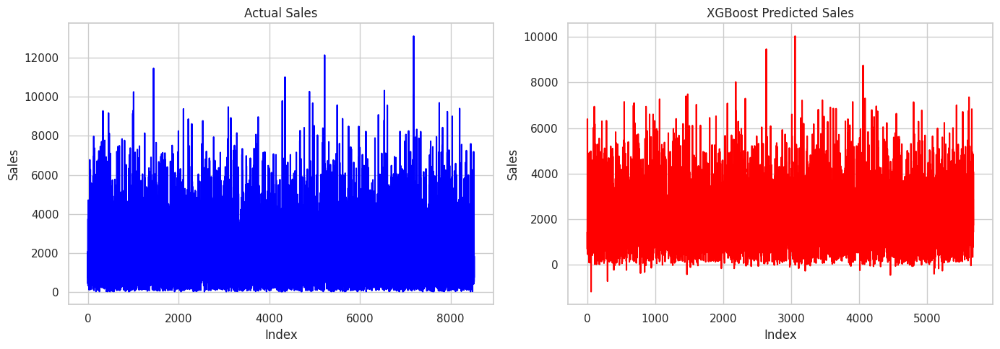

  Item_Identifier  Item_Outlet_Sales  XGB_Predicted_Sales
0           FDA15          3735.1380          1415.786865
1           DRC01           443.4228          1389.302002
2           FDN15          2097.2700           689.857971
3           FDX07           732.3800          2133.037109
4           NCD19           994.7052          6395.259766


In [46]:
# Initialize the XGBoost model
xgb_model = XGBRegressor(objective='reg:squarederror')

# Fit the model on training data
xgb_model.fit(X_train, y_train)

# Make predictions on the test data
xgb_predictions = xgb_model.predict(X_test)

# Assuming 'Item_Outlet_Sales' is the target variable in df1 and df2 doesn't contain this column
# Create a DataFrame for the XGBoost predictions for easy visualization
xgb_predictions_df = pd.DataFrame(xgb_predictions, columns=['XGB_Predicted_Sales'])

# Reset index on df1 to align it with predictions for side-by-side comparison
df1_reset = df1.reset_index(drop=True)
xgb_predictions_df_reset = xgb_predictions_df.reset_index(drop=True)

# Combine actual sales from df1 with XGBoost predicted sales for comparison
comparison_df_xgb = pd.concat([df1_reset, xgb_predictions_df_reset], axis=1)

# Visualization
plt.figure(figsize=(14, 5))

# Plotting actual sales
plt.subplot(1, 2, 1)
sns.lineplot(data=df1['Item_Outlet_Sales'].reset_index(drop=True), color='blue')
plt.title('Actual Sales')
plt.ylabel('Sales')
plt.xlabel('Index')

# Plotting XGBoost predicted sales
plt.subplot(1, 2, 2)
sns.lineplot(data=xgb_predictions_df['XGB_Predicted_Sales'], color='red')
plt.title('XGBoost Predicted Sales')
plt.ylabel('Sales')
plt.xlabel('Index')

plt.tight_layout()
plt.show()

# Optionally, you can display the DataFrame to see actual vs predicted sales
print(comparison_df_xgb[['Item_Identifier', 'Item_Outlet_Sales', 'XGB_Predicted_Sales']].head())

The XGBosst model seems to be performing better than the LightGBM model on making predicitons compared to the actual sales, I will go on to refine the model by hyperamater tuning and gridsearch

Fitting 5 folds for each of 18 candidates, totalling 90 fits
Best parameters found:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}


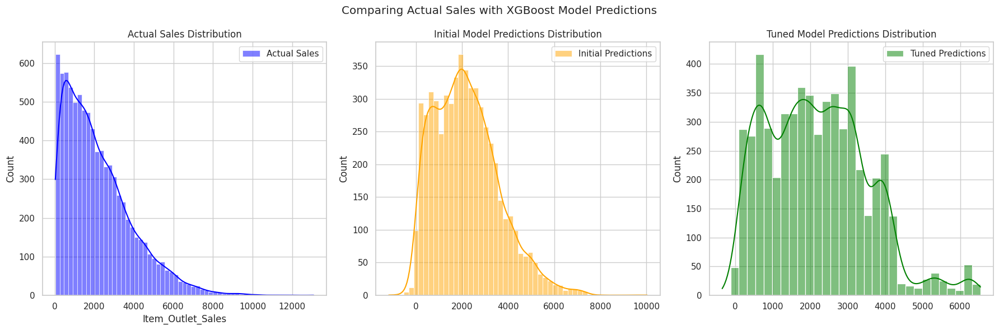

In [47]:
"""
This script focuses on refining an XGBoost model through hyperparameter tuning and comparing the
prediction results of the initial and tuned models against actual sales data. The key steps involved include:
- Hyperparameter tuning using GridSearchCV to find optimal model settings.
- Training the XGBoost model using both initial and tuned parameters.
- Visualizing the comparison of actual sales with the predictions from both models.

The aim is to improve the model's prediction accuracy and assess the impact of tuning on model performance.
"""


# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2]
}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=XGBRegressor(objective='reg:squarederror', random_state=42),
                           param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Print the best parameters found
print("Best parameters found: ", grid_search.best_params_)

# Step 2: Train and Predict with Initial and Tuned XGBoost Models
# Initial XGBoost model
xgb_initial = XGBRegressor(objective='reg:squarederror', random_state=42)
xgb_initial.fit(X_train, y_train)
initial_predictions = xgb_initial.predict(X_test)

# Tuned XGBoost model using best parameters from GridSearchCV
xgb_tuned = grid_search.best_estimator_
tuned_predictions = xgb_tuned.predict(X_test)

# Step 3: Visualization of Actual Sales vs. Model Predictions
# Assuming df1 contains the actual sales data
actual_sales = df1['Item_Outlet_Sales']

# Visualize the results
plt.figure(figsize=(18, 6))

# Plotting actual sales
plt.subplot(1, 3, 1)
sns.histplot(actual_sales, color='blue', kde=True, label='Actual Sales')
plt.title('Actual Sales Distribution')
plt.legend()

# Plotting initial model predictions
plt.subplot(1, 3, 2)
sns.histplot(initial_predictions, color='orange', kde=True, label='Initial Predictions')
plt.title('Initial Model Predictions Distribution')
plt.legend()

# Plotting tuned model predictions
plt.subplot(1, 3, 3)
sns.histplot(tuned_predictions, color='green', kde=True, label='Tuned Predictions')
plt.title('Tuned Model Predictions Distribution')
plt.legend()

plt.suptitle('Comparing Actual Sales with XGBoost Model Predictions')
plt.tight_layout()
plt.show()

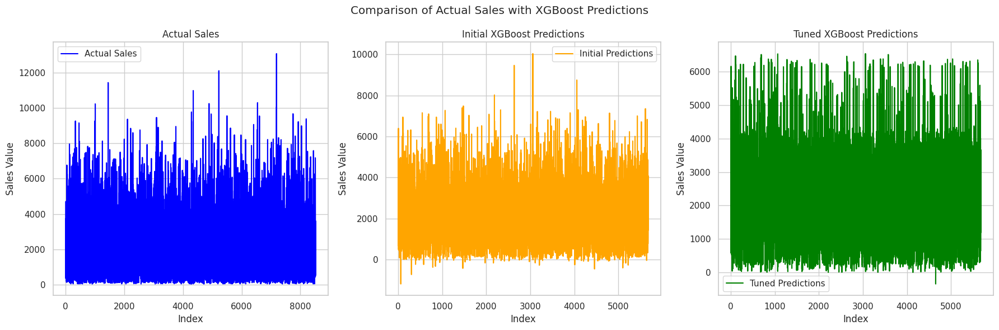

In [48]:
# Convert actual sales, initial model predictions, and tuned model predictions to pandas series for easy plotting
actual_sales_series = pd.Series(df1['Item_Outlet_Sales'].values, name="Actual Sales")
initial_predictions_series = pd.Series(initial_predictions, name="Initial Predictions")
tuned_predictions_series = pd.Series(tuned_predictions, name="Tuned Predictions")

# Set up the matplotlib figure
plt.figure(figsize=(18, 6))

# Plot actual sales
plt.subplot(1, 3, 1)
sns.lineplot(data=actual_sales_series.reset_index(drop=True), color='blue', label='Actual Sales')
plt.title('Actual Sales')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot initial model predictions
plt.subplot(1, 3, 2)
sns.lineplot(data=initial_predictions_series.reset_index(drop=True), color='orange', label='Initial Predictions')
plt.title('Initial XGBoost Predictions')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot tuned model predictions
plt.subplot(1, 3, 3)
sns.lineplot(data=tuned_predictions_series.reset_index(drop=True), color='green', label='Tuned Predictions')
plt.title('Tuned XGBoost Predictions')
plt.xlabel('Index')
plt.ylabel('Sales Value')

plt.suptitle('Comparison of Actual Sales with XGBoost Predictions')
plt.tight_layout()
plt.show()

The tuned model seems to still be experiencing overfitting which requires an alternate approach, I opted to perform log transformation on the dataset,
Log transformation is a mathematical operation applied to data to reduce skewness or compress the range of values. It involves taking the logarithm of each data point, usually base 10 or natural logarithm.

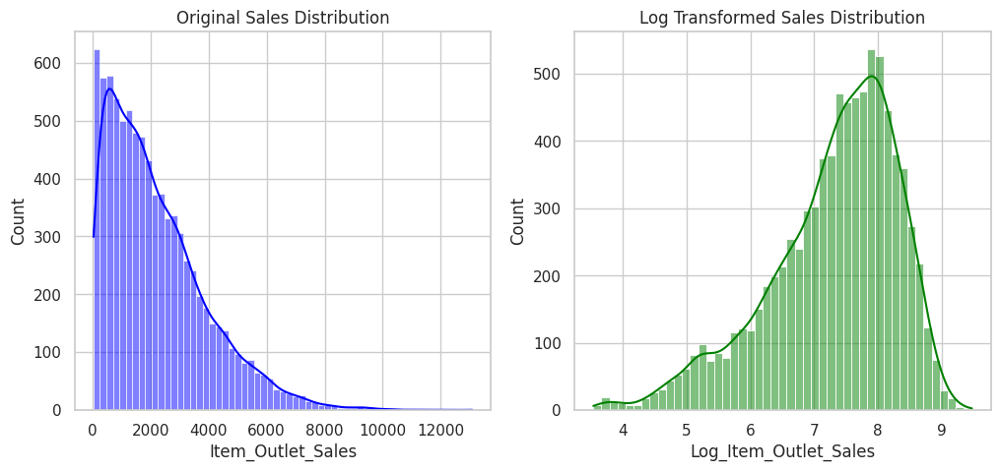

In [49]:
# Before transformation
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(df1['Item_Outlet_Sales'], kde=True, color='blue')
plt.title('Original Sales Distribution')

# Log transformation
df1['Log_Item_Outlet_Sales'] = np.log1p(df1['Item_Outlet_Sales'])

# After transformation
plt.subplot(1, 2, 2)
sns.histplot(df1['Log_Item_Outlet_Sales'], kde=True, color='green')
plt.title('Log Transformed Sales Distribution')

plt.show()

The distribution has been slightly improved and might have a positive impact and improve predictions

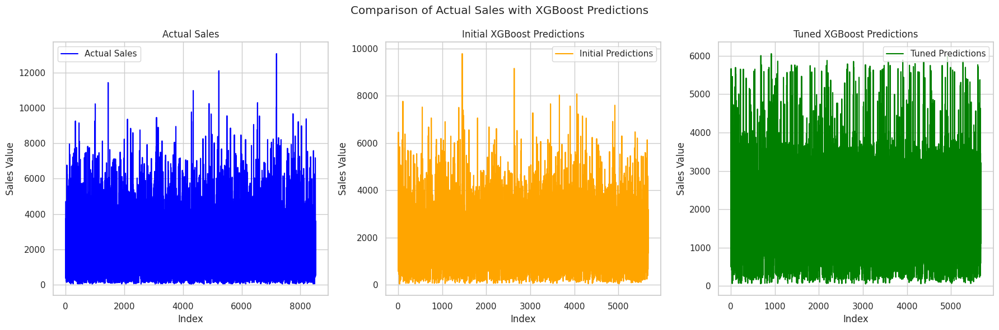

In [50]:
# Apply log transformation to y_train to deal with skewness
y_train_log = np.log1p(y_train)

# Initial XGBoost model
xgb_initial = XGBRegressor(objective='reg:squarederror')
xgb_initial.fit(X_train, y_train_log)

# Predict on X_test (predictions will be in log scale)
log_predictions_initial = xgb_initial.predict(X_test)
# Convert predictions back to original scale
predictions_initial = np.expm1(log_predictions_initial)

# Hyperparameter tuning for XGBoost
param_grid = {
    'n_estimators': [100, 150],
    'max_depth': [3, 5],
    'learning_rate': [0.01, 0.1]
}

grid_search = GridSearchCV(estimator=XGBRegressor(objective='reg:squarederror'),
                           param_grid=param_grid,
                           cv=3,
                           scoring='neg_mean_squared_error')

# Fit the model on the log-transformed y_train
grid_search.fit(X_train, y_train_log)

# Best estimator
xgb_tuned = grid_search.best_estimator_

# Predict with the tuned model (predictions will be in log scale)
log_predictions_tuned = xgb_tuned.predict(X_test)
# Convert predictions back to original scale
predictions_tuned = np.expm1(log_predictions_tuned)

# Convert y_train, predictions_initial, and predictions_tuned to Pandas Series for easy plotting
y_train_series = pd.Series(y_train).reset_index(drop=True)
predictions_initial_series = pd.Series(predictions_initial).reset_index(drop=True)
predictions_tuned_series = pd.Series(predictions_tuned).reset_index(drop=True)

# Visualization
plt.figure(figsize=(18, 6))

# Plot actual sales
plt.subplot(1, 3, 1)
sns.lineplot(data=y_train_series, color='blue', label='Actual Sales')
plt.title('Actual Sales')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot initial model predictions
plt.subplot(1, 3, 2)
sns.lineplot(data=predictions_initial_series, color='orange', label='Initial Predictions')
plt.title('Initial XGBoost Predictions')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot tuned model predictions
plt.subplot(1, 3, 3)
sns.lineplot(data=predictions_tuned_series, color='green', label='Tuned Predictions')
plt.title('Tuned XGBoost Predictions')
plt.xlabel('Index')
plt.ylabel('Sales Value')

plt.suptitle('Comparison of Actual Sales with XGBoost Predictions')
plt.tight_layout()
plt.show()

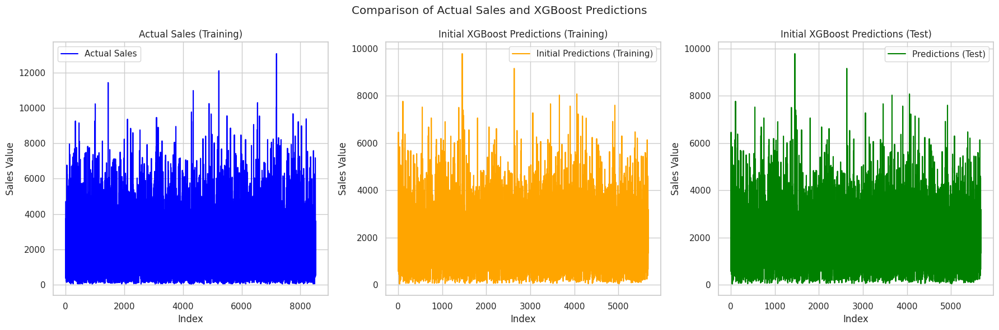

In [51]:
# Step 1: Make predictions on X_test with the initial model
log_predictions_test = xgb_initial.predict(X_test)
# Convert predictions from log scale back to original scale
predictions_test = np.expm1(log_predictions_test)

# Step 2: Visualization for comparison
# Convert y_train, predictions_initial (from training), and predictions_test to Pandas Series for easy plotting
y_train_series = pd.Series(y_train).reset_index(drop=True)
predictions_initial_series = pd.Series(predictions_initial).reset_index(drop=True)  # Assuming predictions_initial are available
predictions_test_series = pd.Series(predictions_test).reset_index(drop=True)

# Visualization
plt.figure(figsize=(18, 6))

# Plot actual sales from training set
plt.subplot(1, 3, 1)
sns.lineplot(data=y_train_series, color='blue', label='Actual Sales')
plt.title('Actual Sales (Training)')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot initial model predictions on training set
plt.subplot(1, 3, 2)
sns.lineplot(data=predictions_initial_series, color='orange', label='Initial Predictions (Training)')
plt.title('Initial XGBoost Predictions (Training)')
plt.xlabel('Index')
plt.ylabel('Sales Value')

# Plot initial model predictions on test set
plt.subplot(1, 3, 3)
sns.lineplot(data=predictions_test_series, color='green', label='Predictions (Test)')
plt.title('Initial XGBoost Predictions (Test)')
plt.xlabel('Index')
plt.ylabel('Sales Value')

plt.suptitle('Comparison of Actual Sales and XGBoost Predictions')
plt.tight_layout()
plt.show()

The models performance is satisfying when comparing it to actual sales, sales from training and the unseen data, XGBoost is the best model to use for this project, the next step is to use grid search estimator to check the best variables that the model cosniders, I will be doing for both LightGBM and XGBoost for comparison

1. Feature: Outlet_Type, Importance: 0.7818275094032288
2. Feature: Item_MRP, Importance: 0.1460149735212326
3. Feature: Outlet_Establishment_Year, Importance: 0.046569522470235825
4. Feature: Outlet_Location_Type, Importance: 0.01062023639678955
5. Feature: Outlet_Size, Importance: 0.003444220405071974
6. Feature: Adjusted_Item_Visibility, Importance: 0.0031079312320798635
7. Feature: Item_Visibility, Importance: 0.0028672951739281416
8. Feature: Item_Weight, Importance: 0.0028384970501065254
9. Feature: Item_Fat_Content, Importance: 0.002709891414269805
10. Feature: Store_Age, Importance: 0.0
11. Feature: Outlet_Type_Encoded, Importance: 0.0


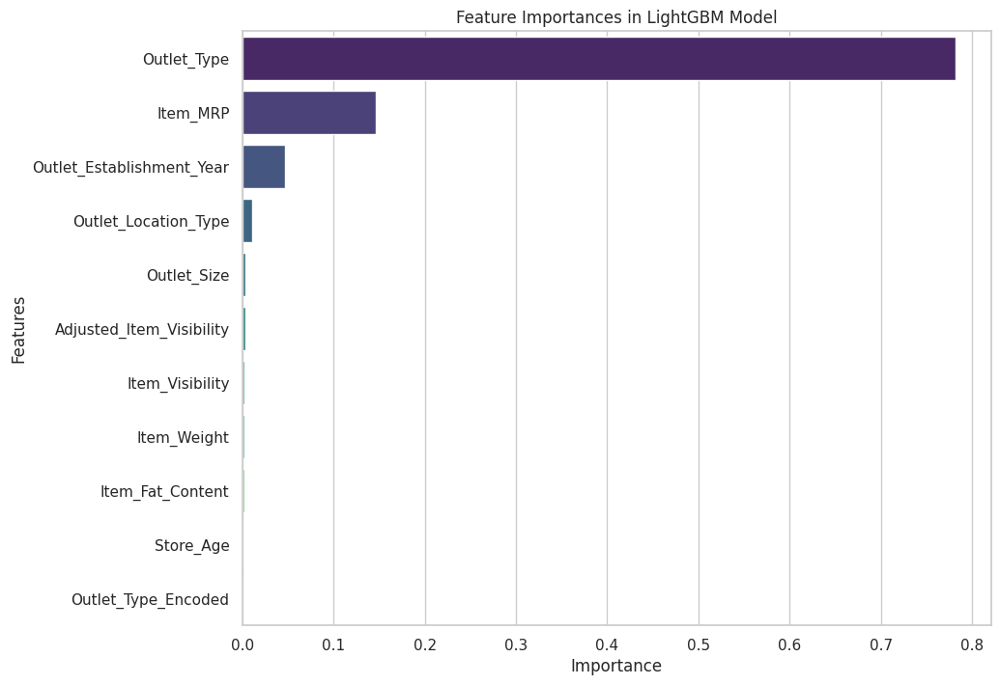

In [52]:
# After running a grid search to find the best parameters for our LightGBM model,
# we use the best_estimator_ attribute to get the best version of the model.
lgbm = grid_search.best_estimator_

# Get feature importances
''' Now, to understand how each feature in our dataset contributes to the model's predictions,
we use the feature_importances_ attribute of our model. This tells us the significance
of each feature in making predictions. '''
importances = lgbm.feature_importances_

# Pair feature names with their importance scores and sort them
sorted_importance = sorted(zip(X_train.columns, importances), key=lambda x: x[1], reverse=True)

''' We then print out these importances, along with the feature names, to see which features
are the most influential in our model's predictions. This helps us focus our data
preprocessing and feature engineering efforts on the most impactful features. '''
for i, (col, importance) in enumerate(sorted_importance):
    print(f"{i+1}. Feature: {col}, Importance: {importance}")

# Visualizing the feature importances
''' Finally, visualizing these feature importances helps us quickly identify which features
have the most impact on our model's decision-making process. It's a crucial step for understanding
our model's behavior and guiding further data analysis and feature selection. '''
plt.figure(figsize=(10, 8))
sns.barplot(x=[x[1] for x in sorted_importance], y=[x[0] for x in sorted_importance], palette="viridis")
plt.title("Feature Importances in LightGBM Model")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

1. Feature: Outlet_Type, Importance: 0.9329617619514465
2. Feature: Item_MRP, Importance: 0.032771997153759
3. Feature: Outlet_Establishment_Year, Importance: 0.010314558632671833
4. Feature: Outlet_Location_Type, Importance: 0.00444999523460865
5. Feature: Adjusted_Item_Visibility, Importance: 0.004247933626174927
6. Feature: Item_Fat_Content, Importance: 0.004089361056685448
7. Feature: Outlet_Size, Importance: 0.003906134981662035
8. Feature: Item_Visibility, Importance: 0.0038500181399285793
9. Feature: Item_Weight, Importance: 0.0034082953352481127
10. Feature: Store_Age, Importance: 0.0
11. Feature: Outlet_Type_Encoded, Importance: 0.0


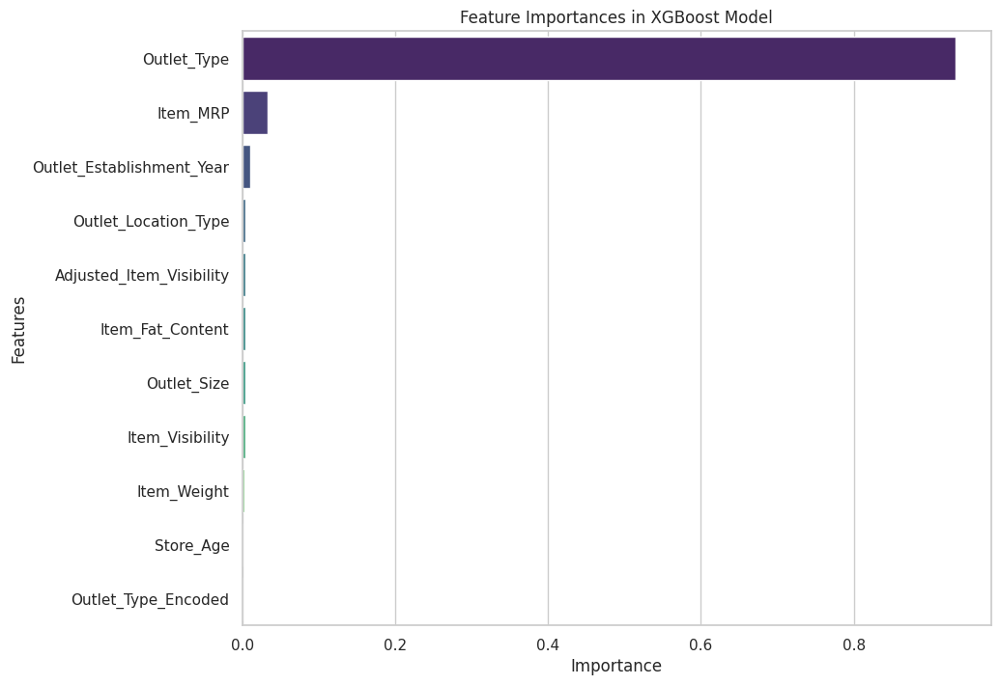

In [53]:
# Get feature importances
importances = xgb_initial.feature_importances_

# Pair feature names with their importance scores and sort them
sorted_importance = sorted(zip(X_train.columns, importances), key=lambda x: x[1], reverse=True)

# Print out feature importances
for i, (col, importance) in enumerate(sorted_importance):
    print(f"{i+1}. Feature: {col}, Importance: {importance}")

plt.figure(figsize=(10, 8))
sns.barplot(x=[x[1] for x in sorted_importance], y=[x[0] for x in sorted_importance], palette="viridis")
plt.title("Feature Importances in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

Outlet type and MRP are the top 2 variables that the 2 models use to make predictions

The next step is to pickle the model and the preprocessing steps to use in creating an app to predict sales

In [54]:
# Pickle the XGBoost model
with open('xgboost_model.pkl', 'wb') as f:
    pickle.dump(xgb_initial, f)

In [56]:
# Create a dictionary to store preprocessing objects
preprocessing_objects = {
    'label_encoder': label_encoder,
    'visibility_avg': visibility_avg,
    'visibility_bins': visibility_bins,
    'mrp_bins': mrp_bins
}

# Save preprocessing objects to a file
with open('preprocessing_objects.pkl', 'wb') as f:
    pickle.dump(preprocessing_objects, f)

In [57]:
# Load the pickled XGBoost model
with open('xgboost_model.pkl', 'rb') as f:
    model = pickle.load(f)

# Load preprocessing objects
with open('preprocessing_objects.pkl', 'rb') as f:
    preprocessing_objects = pickle.load(f)

# Function to preprocess input features
def preprocess_features(df):
    # Extract preprocessing objects
    label_encoder = preprocessing_objects['label_encoder']
    visibility_avg = preprocessing_objects['visibility_avg']
    visibility_bins = preprocessing_objects['visibility_bins']
    mrp_bins = preprocessing_objects['mrp_bins']

    # Apply label encoding to categorical columns
    df['Outlet_Type_Encoded'] = label_encoder.transform(df['Outlet_Type'])

    # Apply mean visibility per item
    df['Adjusted_Item_Visibility'] = df.apply(lambda row: visibility_avg[row['Item_Identifier']] if row['Item_Visibility'] == 0 else row['Item_Visibility'], axis=1)

    # Binning for Item_Visibility
    df['Item_Visibility_Bin'] = pd.cut(df['Item_Visibility'], bins=visibility_bins, labels=['Low', 'Medium', 'High', 'Very High'], right=False)

    # Binning for Item_MRP
    df['Item_MRP_Bin'] = pd.cut(df['Item_MRP'], bins=mrp_bins, labels=['Low', 'Medium', 'High', 'Very High'])

    # Drop unnecessary columns
    df = df.drop(columns=['Item_Identifier', 'Item_Type', 'Outlet_Identifier'])

    return df

# Function to make predictions
def predict_sales(df):
    # Preprocess input features
    df = preprocess_features(df)

    # Make prediction using relevant preprocessed features
    X = df[['Item_Weight', 'Outlet_Type_Encoded', 'Adjusted_Item_Visibility', 'Item_Visibility_Bin', 'Item_MRP_Bin']]

    # Make prediction
    prediction = model.predict(X)

    return prediction

# Streamlit app
def main():
    st.title('Future Sales Prediction')
    st.write('Fill in the details to predict future sales:')

    # Input form for features
    item_identifier = st.text_input('Item Identifier')
    item_weight = st.number_input('Item Weight')
    item_fat_content = st.selectbox('Item Fat Content', ['Low Fat', 'Regular'])
    item_visibility = st.number_input('Item Visibility')
    item_type = st.selectbox('Item Type', ['Snack Foods', 'Dairy', 'Frozen Foods', 'Fruits and Vegetables', 'Others'])
    item_mrp = st.number_input('Item MRP')
    outlet_identifier = st.text_input('Outlet Identifier')
    outlet_establishment_year = st.number_input('Outlet Establishment Year')
    outlet_size = st.selectbox('Outlet Size', ['Small', 'Medium', 'High'])
    outlet_location_type = st.selectbox('Outlet Location Type', ['Tier 1', 'Tier 2', 'Tier 3'])
    outlet_type = st.selectbox('Outlet Type', ['Supermarket Type1', 'Supermarket Type2', 'Supermarket Type3', 'Grocery Store'])

    # Create a DataFrame with the user input features
    user_input = pd.DataFrame({
        'Item_Identifier': [item_identifier],
        'Item_Weight': [item_weight],
        'Item_Fat_Content': [item_fat_content],
        'Item_Visibility': [item_visibility],
        'Item_Type': [item_type],
        'Item_MRP': [item_mrp],
        'Outlet_Identifier': [outlet_identifier],
        'Outlet_Establishment_Year': [outlet_establishment_year],
        'Outlet_Size': [outlet_size],
        'Outlet_Location_Type': [outlet_location_type],
        'Outlet_Type': [outlet_type]
    })

    # Make prediction when button is clicked
    if st.button('Predict'):
        prediction = predict_sales(user_input)
        st.success(f'Predicted Sales: {prediction[0]}')

if __name__ == '__main__':
    main()

2024-04-19 14:31:55.851 
  command:

    streamlit run /usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py [ARGUMENTS]
